In [29]:
import altair as alt
import pandas as pd
import numpy as np

import datetime 

alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [35]:
# This is the full, integrated COVID-19 data at UTLA level for England with cases, deaths, hospitalisations and vaccinations
# See the analyticalTeamDataProcessing notebook for the process that leads to this dataset
# note that the hospitalization data here is probabilistic at UTLA level

pheCovid = pd.read_csv('data/2021_08_04-pheCovid_England_UTLA_WithHospitalData.csv')
pheCovid.head()

,Unnamed: 0,areaCode,areaName,date,cumVaccinationCompleteCoverageByVaccinationDatePercentage,cumVaccinesGivenByPublishDate,newCasesByPublishDate,newDeaths28DaysByDeathDate,newHospitalisations
0,0,E06000003,Redcar and Cleveland,2021-08-04,NaN,NaN,62.0,NaN,0
1,1,E06000014,York,2021-08-04,NaN,NaN,135.0,NaN,0
2,2,E06000050,Cheshire West and Chester,2021-08-04,NaN,NaN,145.0,NaN,0
3,3,E08000001,Bolton,2021-08-04,NaN,NaN,76.0,NaN,0
4,4,E08000016,Barnsley,2021-08-04,NaN,NaN,130.0,NaN,0


In [37]:
chart = alt.Chart(pheCovid).mark_rect().encode(
    x='date:T',
    y='areaName:O',
    color=alt.Color('newHospitalisations:Q', scale=alt.Scale(scheme='yellowgreenblue')),
    tooltip=[
        alt.Tooltip('date:T', title='date'),
        alt.Tooltip('areaName', title='areaName'),
        alt.Tooltip('newHospitalisations:Q', title='newHospitalisations')
    ]).properties(width=1000, height=2000)

In [23]:
chart.save('chart.html')

## Relating to the rest of the PHE Indicator Data

Now that the full PHE data is available at UTLA level, we can relate this data to PHE's regular health indicator data set. We can use the Area Code fields to match these two data sets. However, the indicator data is huge so we'lll need to identify the indicators and also a time-window as well to filter this data.

In [8]:
phe_indicators_data = pd.read_csv('./data/Public Health Outcomes Framework/indicators-CountyUA.data.csv')
phe_indicators_data.head()

/Users/cagatayturkay/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3147: DtypeWarning: Columns (24,25) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Indicator ID,Indicator Name,Parent Code,Parent Name,Area Code,Area Name,Area Type,Sex,Age,Category Type,...,Upper CI 99.8 limit,Count,Denominator,Value note,Recent Trend,Compared to England value or percentiles,Compared to Region value or percentiles,Time period Sortable,New data,Compared to goal
0,90362,A01a - Healthy life expectancy at birth,NaN,NaN,E92000001,England,England,Male,All ages,NaN,...,NaN,NaN,NaN,NaN,NaN,Not compared,Not compared,20090000,NaN,NaN
1,90362,A01a - Healthy life expectancy at birth,NaN,NaN,E92000001,England,England,Female,All ages,NaN,...,NaN,NaN,NaN,NaN,NaN,Not compared,Not compared,20090000,NaN,NaN
2,90362,A01a - Healthy life expectancy at birth,E92000001,England,E12000001,North East region,Region,Male,All ages,NaN,...,NaN,NaN,NaN,NaN,NaN,Worse,Not compared,20090000,NaN,NaN
3,90362,A01a - Healthy life expectancy at birth,E92000001,England,E12000002,North West region,Region,Male,All ages,NaN,...,NaN,NaN,NaN,NaN,NaN,Worse,Not compared,20090000,NaN,NaN
4,90362,A01a - Healthy life expectancy at birth,E92000001,England,E12000003,Yorkshire and the Humber region,Region,Male,All ages,NaN,...,NaN,NaN,NaN,NaN,NaN,Worse,Not compared,20090000,NaN,NaN


In [9]:
# an example of relating to the indicators

# the meta-data has the information on these indicators

indicatorsChosen = ["Deprivation score (IMD 2019)"]
filteredIndicatorData = phe_indicators_data[phe_indicators_data['Indicator Name'].isin(indicatorsChosen)][["Area Code", "Value"]]

In [56]:
new_df = pd.merge(pheCovid, filteredIndicatorData,  how='left', left_on=['areaCode'], right_on = ['Area Code'])
# Drop the extra Area Code column from merging
new_df = new_df.drop(['Area Code', 'Unnamed: 0'], axis=1)
#convert date to datetime
new_df.date = pd.to_datetime(new_df.date)
# rename the generic Value into the name
new_df.rename(columns = {'Value':indicatorsChosen[0]}, inplace = True)
#fill empty values with 0
new_df.fillna(0, inplace = True)

In [51]:
new_df.dtypes

areaCode                                                             object
areaName                                                             object
date                                                         datetime64[ns]
cumVaccinationCompleteCoverageByVaccinationDatePercentage           float64
cumVaccinesGivenByPublishDate                                       float64
newCasesByPublishDate                                               float64
newDeaths28DaysByDeathDate                                          float64
newHospitalisations                                                   int64
Deprivation score (IMD 2019)                                        float64
dtype: object

In [59]:
#let's sort the values by date so that the groupby keeps them in temporal order
new_df2 = new_df.sort_values(['date'],ascending=True)
new_df2 = new_df2.reset_index(drop=True)
new_df2

,areaCode,areaName,date,cumVaccinationCompleteCoverageByVaccinationDatePercentage,cumVaccinesGivenByPublishDate,newCasesByPublishDate,newDeaths28DaysByDeathDate,newHospitalisations,Deprivation score (IMD 2019)
0,E10000012,Essex,2020-03-02,0.0,0.0,0.0,1.0,0,17.016
1,E06000060,Buckinghamshire,2020-03-03,0.0,0.0,0.0,1.0,0,10.052
2,E10000024,Nottinghamshire,2020-03-03,0.0,0.0,0.0,1.0,0,18.999
3,E10000012,Essex,2020-03-03,0.0,0.0,0.0,0.0,0,17.016
4,E10000012,Essex,2020-03-04,0.0,0.0,0.0,0.0,0,17.016
...,...,...,...,...,...,...,...,...,...
75346,E10000007,Derbyshire,2021-08-04,0.0,0.0,386.0,0.0,0,18.392
75347,E06000008,Blackburn with Darwen,2021-08-04,0.0,0.0,29.0,0.0,0,36.013
75348,E06000039,Slough,2021-08-04,0.0,0.0,66.0,0.0,0,22.965
75349,E10000016,Kent,2021-08-04,0.0,0.0,634.0,0.0,0,19.538


In [73]:
new_df["newHospitalisations"].max()

208

In [74]:
new_df2["newHospitalisations"].max()

208

In [ ]:
alt.Chart(new_df2).mark_rect().encode(
    x='date:T',
    y='areaName:O',
    color=alt.Color('newCasesByPublishDate:Q', scale=alt.Scale(scheme='yellowgreenblue')),
    tooltip=[
        alt.Tooltip('date:T', title='date'),
        alt.Tooltip('areaName', title='areaName'),
        alt.Tooltip('newHospitalisations:Q', title='newHospitalisations')
    ]).properties(width=1000, height=2000)

In [13]:
fullTimeDataFrame = None

# there are gaps in the time-series data so we need to make sure that all the time series are of the same size
# the following loop will have 1 dataframe for each area with equal-sized time-series

# first create a dataframe covering the full datetime range
fullDateRange = pd.date_range(start=new_df["date"].min(), end=new_df["date"].max())
fullDateRange
fullDateRangeData = pd.DataFrame(index=fullDateRange)
fullDateRangeData["dates"] = fullDateRange
fullDateRangeData

#metaDataDF = pd.DataFrame(columns = ['areaCode', 'areaName', indicatorsChosen[0]])
metaDataList = []

for g, data in new_df2.groupby('areaCode'):
    dataC = data.set_index(pd.DatetimeIndex(data['date']))
    dataCF = pd.merge(fullDateRangeData, dataC,  how='left', left_index = True, right_index=True)
    #print(" dataC Size: ", len(dataC))
    #print("dataCF Size: ", len(dataCF))
    
    #print(dataC.head())
    #print("%%%%")
    
    ## Tidy up the columns and fill in empty values that we get as a result of the full time-range mapping
    dataCF = dataCF.drop(['date'], axis=1)
    dataCF.rename(columns = {'dates':'date'}, inplace = True)
    dataCF["areaCode"] = g
    dataCF["areaName"] = data["areaName"].iloc[0]
    dataCF[indicatorsChosen[0]] = data[indicatorsChosen[0]].iloc[0]
    dataCF.fillna(0, inplace = True)
    dataCF.reset_index(inplace = True)
    
    metaDataDict = {
        'areaCode': g ,
        'areaName': data["areaName"].iloc[0],
        indicatorsChosen[0]: data[indicatorsChosen[0]].iloc[0]
    }
    metaDataList.append(metaDataDict)
    
    try:
        # check if we have a DataFrame created
        fullTimeDataFrame = pd.concat([fullTimeDataFrame, dataCF])
    except:
        print("This is None")
        fullTimeDataFrame = dataCF
    #print(g)
    #print(dataCF.head())
    #print("--------")
    
# The metaDataDF carries the data at the aggregate level, i.e., one row for a single UTLA
metaDataDF = pd.DataFrame(metaDataList)

# let's clear the indexes introduced
fullTimeDataFrame.reset_index(inplace = True)
fullTimeDataFrame = fullTimeDataFrame.drop(['level_0', 'index'], axis=1)
#sort the values by time to make sure that we are getting consistent time series
fullTimeDataFrame = fullTimeDataFrame.sort_values(['date'],ascending=True)
fullTimeDataFrame

,date,areaCode,areaName,cumVaccinationCompleteCoverageByVaccinationDatePercentage,cumVaccinesGivenByPublishDate,newCasesByPublishDate,newDeaths28DaysByDeathDate,newHospitalisations,Deprivation score (IMD 2019)
0,2020-03-02,E06000001,Hartlepool,0.0,0.0,0.0,0.0,0.0,35.037
45327,2020-03-02,E08000033,Calderdale,0.0,0.0,0.0,0.0,0.0,26.351
32302,2020-03-02,E08000007,Stockport,0.0,0.0,0.0,0.0,0.0,20.826
63562,2020-03-02,E09000032,Wandsworth,0.0,0.0,0.0,0.0,0.0,16.611
14067,2020-03-02,E06000030,Swindon,0.0,0.0,0.0,0.0,0.0,18.622
...,...,...,...,...,...,...,...,...,...
41158,2021-08-04,E08000024,Sunderland,0.0,0.0,118.0,0.0,0.0,30.586
36469,2021-08-04,E08000014,Sefton,0.0,0.0,127.0,0.0,0.0,27.035
51057,2021-08-04,E09000007,Camden,0.0,0.0,102.0,0.0,0.0,20.131
21881,2021-08-04,E06000044,Portsmouth,0.0,0.0,108.0,0.0,0.0,26.899


In [14]:
# Creating the lists from the aggregated dataframe
#hospitalizationArrays = new_df.groupby('areaCode')['newCasesByPublishDate'].apply(list)
dataAsTimeSeries = fullTimeDataFrame.groupby('areaCode').agg(lambda x: list(x))
# dataAsTimeSeries.head()

## Time-series analysis

Now that the data is ready and in a form that is suitable to be treated as time-series, we can make use of the time series libraries to do some analysis with the data.

We can use two libraries here:

- tslearn - https://tslearn.readthedocs.io/en/stable/index.html - which comes with useful classification/clustering/regression tools
- tsfresh - https://tsfresh.readthedocs.io/en/latest/index.html - provides lots of features/metrics that we can use to analyse the time-series through

In [85]:
# Here is the function to convert the data into the format that tslearn accepts

#from tslearn.utils import to_time_series_dataset
#tslearn_formatted_TimeSeries = to_time_series_dataset(dataAsTimeSeries["newDeaths28DaysByDeathDate"].tolist())

## Clustering by time-series data directly

In [108]:
# First experiment with clustering  -- this is based on the kShape example 
# https://tslearn.readthedocs.io/en/stable/auto_examples/clustering/plot_kshape.html#sphx-glr-auto-examples-clustering-plot-kshape-py
import numpy
import matplotlib.pyplot as plt

from tslearn.utils import to_time_series_dataset
from tslearn.clustering import KShape
from tslearn.datasets import CachedDatasets
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

timeSeriesDataColumnToClusterOn = "newDeaths28DaysByDeathDate"

# decide which time-series feature we want to cluster on
tslearn_formatted_TimeSeries = to_time_series_dataset(dataAsTimeSeries[timeSeriesDataColumnToClusterOn].tolist())

# in a similar fashion 

seed = 0
numpy.random.seed(seed)
#X_train, y_train, X_test, y_test = CachedDatasets().load_dataset("Trace")
# Keep first 3 classes and 50 first time series
X_train  = tslearn_formatted_TimeSeries
#X_train = X_train[:50]
#numpy.random.shuffle(X_train)
# For this method to operate properly, prior scaling is required
X_train = TimeSeriesScalerMeanVariance().fit_transform(X_train)
sz = X_train.shape[1]

number_clusters = 3

# kShape clustering
ks = KShape(n_clusters=number_clusters, verbose=True, random_state=seed)
y_pred = ks.fit_predict(X_train)


0.054 --> 0.052 --> 0.051 --> 0.051 --> 


In [109]:
# let's add the clustering results as a meta-data column
metaDataDF["classLabels"] = y_pred

# This is another way of aggregating the data, currently not used
clusterLevelData = metaDataDF.groupby('classLabels').agg(lambda x: list(x))
#clusterLevelData.head()

# clusterLevelData['Deprivation score (IMD 2019)']


### Visualising the resulting clusters

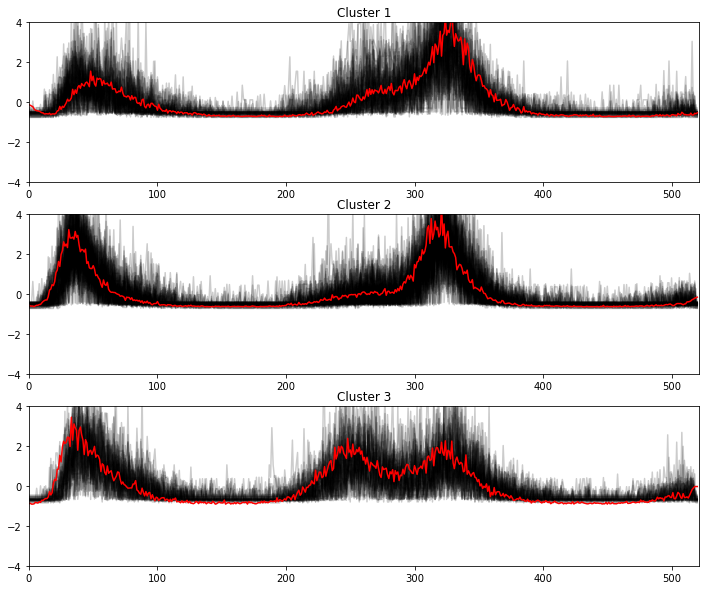

In [110]:
# plottting the k-Shape results with each cluster members and the centroid
# first using the standard matplotlib approach from the example

plt.figure(figsize=(12, 10))
for yi in range(number_clusters):
    plt.subplot(number_clusters, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)
    plt.plot(ks.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.title("Cluster %d" % (yi + 1))

#plt.tight_layout()
plt.show()

In [111]:

from altair.expr import datum

# this is the dataframe to use in further visualisations
metaDToMerge = metaDataDF[["areaCode", "classLabels"]]
# This is merging the original raw data with the clustering labels that is coming from the clustering process above
jointFinalData = pd.merge(new_df, metaDToMerge,  how='left', left_on='areaCode', right_on='areaCode')


# This is just a control visualisation to check the data
# alt.Chart(jointFinalData).mark_rect().encode(
#     x='date:T',
#     y='areaName:O',
#     color=alt.Color('newCasesByPublishDate:Q', scale=alt.Scale(scheme='yellowgreenblue')),
#     tooltip=[
#         alt.Tooltip('date:T', title='date'),
#         alt.Tooltip('areaName', title='areaName'),
#         alt.Tooltip('newHospitalisations:Q', title='newHospitalisations'),
#         alt.Tooltip('classLabels:Q', title='classLabels')
#     ]).properties(width=1000, height=2000)

base = alt.Chart(jointFinalData).mark_rect().encode(
    x='date:T',
    y='areaName:O',
    color=alt.Color(timeSeriesDataColumnToClusterOn, scale=alt.Scale(scheme='yellowgreenblue')),
    tooltip=[
         alt.Tooltip('date:T', title='date'),
         alt.Tooltip('areaName', title='areaName'),
         alt.Tooltip(timeSeriesDataColumnToClusterOn, title='newHospitalisations'),
         alt.Tooltip('classLabels:Q', title='classLabels')
    ])

chart = alt.vconcat()
for clusterID in np.arange(number_clusters):
    chart |= base.transform_filter(datum.classLabels == clusterID)
chart

alt.HConcatChart(...)

### Visualising the underlying factors per cluster

In [112]:
# This is the deprivation score distributions per class

alt.Chart(metaDataDF).mark_tick(thickness=3).encode(
    x='Deprivation score (IMD 2019):Q',
    y='classLabels:N',
    tooltip=[
        alt.Tooltip('areaName', title='areaName'),
    ]).properties(width=1000, height=200)

alt.Chart(...)

### Further explorations

1. Computing a distance-matrix that we could use for different purposes such as graph cosntruction and/or MDS layouts, etc.

In [ ]:
from tslearn.metrics import cdist_dtw

distanceMatrix = cdist_dtw(tslearn_formatted_TimeSeries)

distanceMatrix.shape
dmDF = pd.DataFrame(distanceMatrix)
dmDF.head()